In [1]:
import os
import sys
module_path = os.path.abspath(os.path.join('../src/'))
if module_path not in sys.path:
    sys.path.append(module_path)

os.chdir("../")
print("Current working directory:", os.getcwd())

Current working directory: /home/ec2-user/workspace/loce


## Retrieval

/home/ec2-user/workspace/venvs/gcpv_venv_no_gpu/lib/python3.9/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


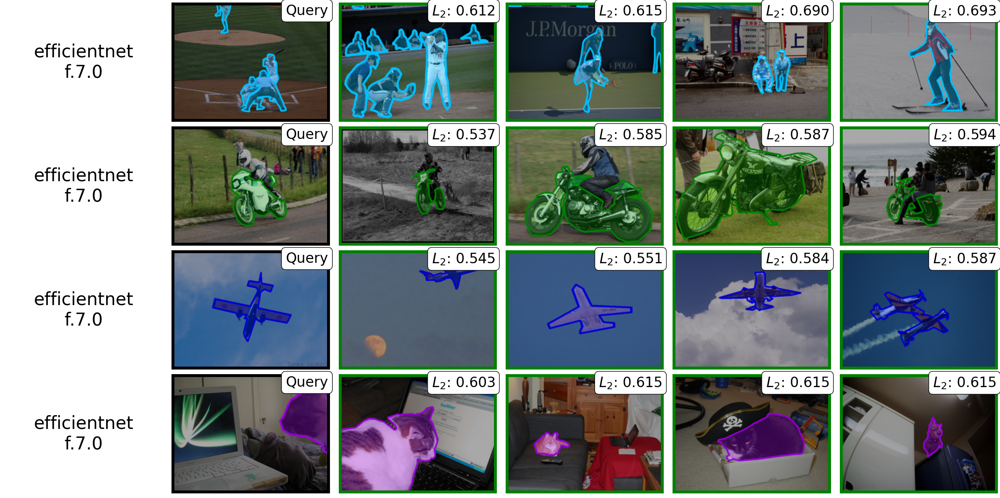

In [2]:
%matplotlib inline

import matplotlib.pyplot as plt

from loce import LoCEExperimentConstants, LoCEMultilayerStorageRetrieval

in_dir = "./experiment_outputs/optimized_loces_coco/"
model_tag = "efficientnet"
segmentation_type = "original"

layer = "features.7.0"
categories = LoCEExperimentConstants.MSCOCO_CATEGORIES_ALL

# images to retrieve, w.r.t. to their concept embeddings
img_person = ["000000002153.jpg"]
img_moto = ["000000007816.jpg"]
img_plane = ["000000167540.jpg"]
img_cats = ["000000115885.jpg"]
imgs_all = img_person + img_moto + img_plane + img_cats
labels_all = [1]*len(img_person) + [4]*len(img_moto) + [5]*len(img_plane) + [17]*len(img_cats)

# number of samples to retrieve
n_samples = 5
tile_size = (240, 180)

loce_dir = os.path.join(in_dir, f"loce_{segmentation_type}_{model_tag}")

fig, axes = plt.subplots(len(imgs_all), n_samples + 1, figsize=((n_samples + 1) * 2 * 2, 3 * len(imgs_all)))

retriever = LoCEMultilayerStorageRetrieval(loce_dir)
retriever.retrieve_images_vs_selected_categories_one_plot(axes, imgs_all, labels_all, categories, layer, model_tag, n_pos_samples=n_samples, image_tile_size=tile_size)

plt.tight_layout()
plt.show()
plt.close()

## Retrieval mAP@k

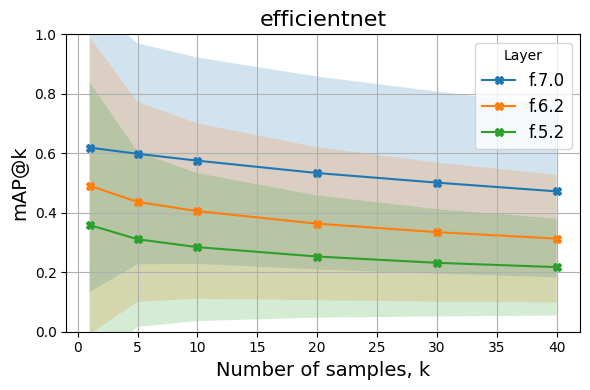

In [3]:
from typing import Dict, Iterable
import numpy as np
from loce import shorten_layer_name


def accumulate_mAP(result: Dict[str, Dict[int, Dict[int, np.ndarray]]],
                   categories: Iterable[int],
                   layers: Iterable[str],
                   mean_average_precision_at_n: Iterable[int],
                   ) -> Dict[str, Dict[int, np.ndarray]]:
    
    accumulated = {l: {n: [] for n in mean_average_precision_at_n} for l in layers}

    for c in categories:

        for l in layers:
            for n in mean_average_precision_at_n:
                accumulated[l][n].append(result[l][c][n])

    accumulated = {l: {n: np.hstack(accumulated[l][n]) for n in mean_average_precision_at_n} for l in layers}

    return accumulated


mean_average_precision_at_n = [1, 5, 10, 20, 30, 40]
retrieval_layers = ["features.5.2", "features.6.2", "features.7.0"]

retrieval_in_layers = dict()

fig, ax = plt.subplots(figsize=(6, 4))

for layer in retrieval_layers:
    ## retriever is same as above
    retrieval_mAP = retriever.retrieval_mAP(categories, layer, mean_average_precision_at_n)

    retrieval_in_layers[layer] = retrieval_mAP

layers_short = [shorten_layer_name(l) for l in retrieval_layers]

accumulated_results = accumulate_mAP(retrieval_in_layers, categories, retrieval_layers, mean_average_precision_at_n)
            
mean_average_precision_at_n = np.array(list(mean_average_precision_at_n))
            
for l, ls in zip(retrieval_layers[::-1], layers_short[::-1]):
    values = accumulated_results[l]
    means = np.array([values[n].mean() for n in mean_average_precision_at_n])
    stds = np.array([values[n].std() for n in mean_average_precision_at_n])

                                
    line, = ax.plot(mean_average_precision_at_n, means, marker="X", label=ls)
    ax.fill_between(mean_average_precision_at_n, means - stds, means + stds, alpha=0.2)

                        
    ax.set_title(model_tag, fontsize=16)

    ax.set_xlabel('Number of samples, k', fontsize=14)
        
    ax.set_ylabel('mAP@k', fontsize=14)
    ax.set_ylim(0, 1) 
    ax.grid(True)
        
plt.legend(title="Layer", fontsize=12)
plt.tight_layout()
plt.show()
plt.close()

## Outliers

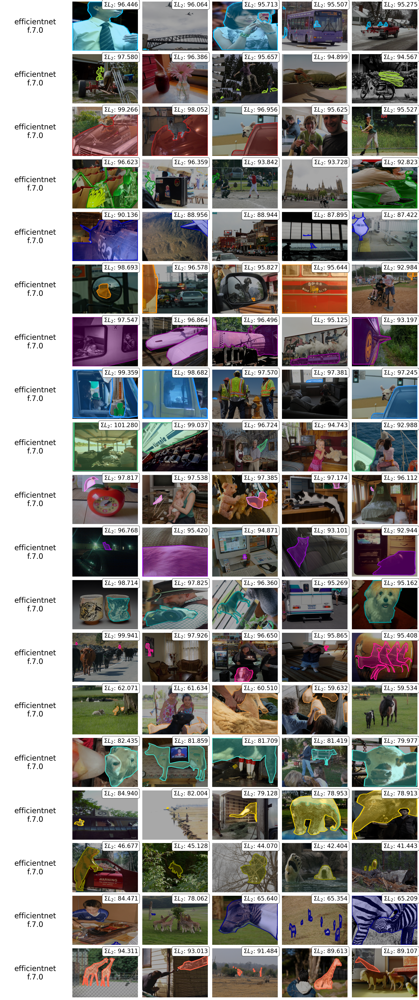

In [4]:
fig, axes = plt.subplots(len(categories), n_samples + 1, figsize=((n_samples + 1) * 2 * 2, 3 * len(categories)))

# retriever is same as above
retriever.retrieve_outliers_one_plot(axes, categories, layer, model_tag, n_samples=n_samples, show_lloce=False, image_tile_size=tile_size)

plt.tight_layout()
plt.show()
plt.close()